In [6]:
import pandas as pd
from sklearn.utils import resample

# Load dataset into pandas dataframe
df = pd.read_csv("dataset.csv")

# Separate majority and minority classes
majority_class = df[df.hospital_death==0]
minority_class = df[df.hospital_death==1]

# Oversample minority class
minority_class_upsampled = resample(minority_class,
                                 replace=True,     # sample with replacement
                                 n_samples=len(majority_class), # set number of samples to match majority class
                                 random_state=42)  # reproducible results

# Combine majority class with upsampled minority class
balanced_df = pd.concat([majority_class, minority_class_upsampled])

# Save balanced dataset to a CSV file
balanced_df.to_csv("balanced_dataset.csv", index=False)

In [25]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import re
import string
import nltk

df = pd.read_csv('dataset.csv')

In [26]:
# dropping empty columbs
df = df.dropna(axis=1, how='all')

#drop rows with missing values
df = df.dropna(axis=0, how='any')
print(df.describe())
    

        encounter_id     patient_id   hospital_id           age           bmi   
count   56935.000000   56935.000000  56935.000000  56935.000000  56935.000000  \
mean    65602.205901   65639.615087    105.792008     62.586142     29.288534   
std     37787.119140   37794.344995     64.672676     16.635116      8.320370   
min         3.000000       1.000000      2.000000     16.000000     14.844926   
25%     32810.500000   33041.500000     39.000000     53.000000     23.704715   
50%     65786.000000   65595.000000    109.000000     65.000000     27.768126   
75%     98229.500000   98296.000000    171.000000     75.000000     33.062057   
max    131049.000000  131051.000000    204.000000     89.000000     67.814990   

       elective_surgery        height        icu_id  pre_icu_los_days   
count      56935.000000  56935.000000  56935.000000      56935.000000  \
mean           0.160077    169.795598    525.548836          0.825686   
std            0.366681     10.762003    221.824181

In [47]:
print(df.columns)
print(len(df.columns))

Index(['encounter_id', 'patient_id', 'hospital_id', 'age', 'bmi',
       'elective_surgery', 'ethnicity', 'gender', 'height', 'icu_admit_source',
       'icu_id', 'icu_stay_type', 'icu_type', 'pre_icu_los_days', 'weight',
       'apache_2_diagnosis', 'apache_3j_diagnosis', 'apache_post_operative',
       'arf_apache', 'gcs_eyes_apache', 'gcs_motor_apache',
       'gcs_unable_apache', 'gcs_verbal_apache', 'heart_rate_apache',
       'intubated_apache', 'map_apache', 'resprate_apache', 'temp_apache',
       'ventilated_apache', 'd1_diasbp_max', 'd1_diasbp_min',
       'd1_diasbp_noninvasive_max', 'd1_diasbp_noninvasive_min',
       'd1_heartrate_max', 'd1_heartrate_min', 'd1_mbp_max', 'd1_mbp_min',
       'd1_mbp_noninvasive_max', 'd1_mbp_noninvasive_min', 'd1_resprate_max',
       'd1_resprate_min', 'd1_spo2_max', 'd1_spo2_min', 'd1_sysbp_max',
       'd1_sysbp_min', 'd1_sysbp_noninvasive_max', 'd1_sysbp_noninvasive_min',
       'd1_temp_max', 'd1_temp_min', 'h1_diasbp_max', 'h1_diasbp_

In [27]:
# df.drop(['Unnamed: 83'],  axis=1, inplace=True)
df.drop(['encounter_id', 'patient_id', 'icu_id', 'hospital_id', 'apache_4a_hospital_death_prob', 'apache_4a_icu_death_prob'], axis=1, inplace=True)

In [20]:
import plotly.express as px
import plotly.offline as py
import plotly.graph_objs as go
import plotly.tools as tls
from plotly.subplots import make_subplots
import plotly.figure_factory as ff

fig = px.histogram(df[['age', 'gender', 'hospital_death', 'bmi']].dropna(), x= "age", y = "hospital_death", color = 'gender',
                  marginal = 'box', hover_data = df[['age', 'gender', 'hospital_death', 'bmi']].columns)
fig.show()

In [28]:
# one hot encode the categorical variables
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
import pandas as pd

dummies = pd.get_dummies(df[['icu_admit_source', 'ethnicity', 'gender',  'apache_3j_bodysystem', 'apache_2_bodysystem', 'icu_type', 'icu_stay_type']])
# concatenate the one-hot encoded columns with the original DataFrame
df = pd.concat([df, dummies], axis=1)
# drop the original categorical columns
df.drop(['icu_admit_source', 'ethnicity', 'gender',  'apache_3j_bodysystem', 'apache_2_bodysystem', 'icu_type', 'icu_stay_type'], axis=1, inplace=True)
print(df.columns)

Index(['age', 'bmi', 'elective_surgery', 'height', 'pre_icu_los_days',
       'weight', 'apache_2_diagnosis', 'apache_3j_diagnosis',
       'apache_post_operative', 'arf_apache',
       ...
       'icu_type_CSICU', 'icu_type_CTICU', 'icu_type_Cardiac ICU',
       'icu_type_MICU', 'icu_type_Med-Surg ICU', 'icu_type_Neuro ICU',
       'icu_type_SICU', 'icu_stay_type_admit', 'icu_stay_type_readmit',
       'icu_stay_type_transfer'],
      dtype='object', length=116)


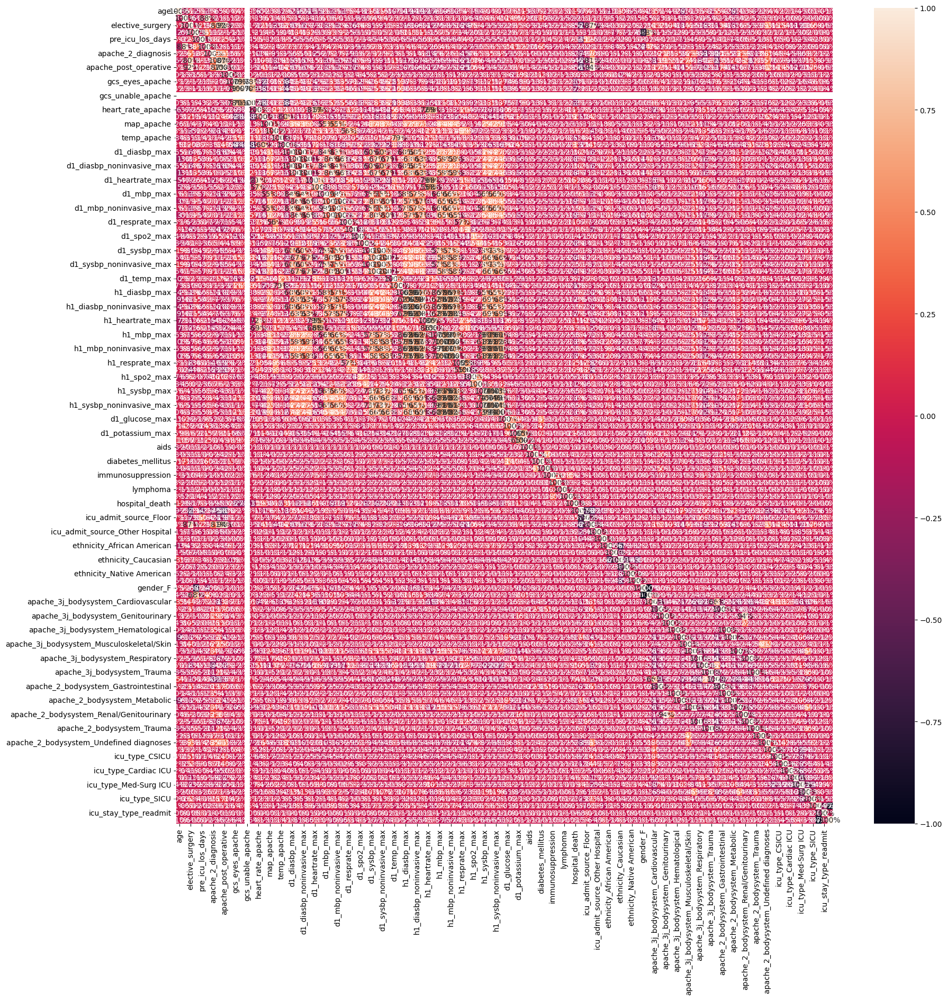

In [29]:
plt.figure(figsize=(20,20))
sns.heatmap(df.corr(), annot=True, fmt='.0%')
plt.show()

/Users/malvikavaidya/Documents/gitCode/DSP-Final-Project/venv/lib/python3.10/site-packages/seaborn/axisgrid.py:848: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.



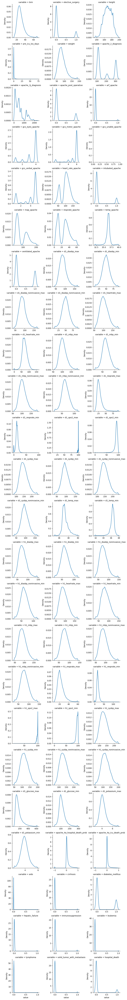

In [97]:
# density distribution for numerical variables 
unpivot = pd.melt(df, df.describe().columns[0], df.describe().columns[1:])

fig2 = sns.FacetGrid(unpivot, col = 'variable', col_wrap = 3,
                    sharex = False, sharey = False)
fig2.map(sns.kdeplot, "value")
plt.show()

In [ ]:
# correlation and feature removal

# import pandas as pd

# # Find correlation matrix
# corr_matrix = df.corr().abs()
# # Set threshold for correlation coefficient
# threshold = 0.85

# # copy df into dropped_df
# dropped_df = df.copy()
# # Find features with correlation greater than threshold
# high_corr_features = set()
# for i in range(len(corr_matrix.columns)):
#     for j in range(i):
#         if corr_matrix.iloc[i, j] >= threshold:
#             colname_i = corr_matrix.columns[i]
#             colname_j = corr_matrix.columns[j]
#             if colname_i not in high_corr_features:
#                 high_corr_features.add(colname_j)

# # Remove highly correlated features from DataFrame
# df.drop(high_corr_features, axis=1, inplace=True)

In [81]:
print(len(df.columns))

107


In [5]:
# removing outliers using z-score
import pandas as pd
from scipy.stats import zscore

# Calculate z-scores for each feature
z_scores = df.apply(zscore)

# # Identify outliers by setting a threshold for z-score
threshold = 3
outliers = (z_scores > threshold).any(axis=1)

# # Remove outliers from DataFrame
df = df[~outliers]
print(df.shape)

(14133, 116)


In [83]:
from sklearn.feature_selection import f_classif
from sklearn.model_selection import train_test_split
import numpy as np
import pandas as pd

# set the target variable column name
target_col = 'hospital_death'

# split the data into training and testing sets
train_df, test_df = train_test_split(df, test_size=0.2, random_state=42)

# initialize the list of selected features
selected_features = []

# create a copy of the training set to keep track of the remaining features
remaining_features = train_df.columns.drop(target_col)

# iterate over the remaining features and select the one that has the highest F-value
while len(remaining_features) > 0:
    f_values, p_values = f_classif(train_df[remaining_features], train_df[target_col])
    best_feature_index = np.argmax(f_values)
    best_feature = remaining_features[best_feature_index]
    
    # add the best feature to the list of selected features and remove it from the remaining features
    selected_features.append(best_feature)
    remaining_features = remaining_features.drop(best_feature)
    
    # print the selected feature and its corresponding F-value
    # print('Selected feature:', best_feature, 'with F-value:', f_values[best_feature_index])

# create a new DataFrame with the selected features
df = train_df[selected_features + [target_col]]

# display the selected features
print('Selected features:', selected_features)

/Users/malvikavaidya/Documents/gitCode/DSP-Final-Project/venv/lib/python3.10/site-packages/sklearn/feature_selection/_univariate_selection.py:108: RuntimeWarning:

invalid value encountered in divide

/Users/malvikavaidya/Documents/gitCode/DSP-Final-Project/venv/lib/python3.10/site-packages/sklearn/feature_selection/_univariate_selection.py:108: RuntimeWarning:

invalid value encountered in divide

/Users/malvikavaidya/Documents/gitCode/DSP-Final-Project/venv/lib/python3.10/site-packages/sklearn/feature_selection/_univariate_selection.py:108: RuntimeWarning:

invalid value encountered in divide

/Users/malvikavaidya/Documents/gitCode/DSP-Final-Project/venv/lib/python3.10/site-packages/sklearn/feature_selection/_univariate_selection.py:108: RuntimeWarning:

invalid value encountered in divide

/Users/malvikavaidya/Documents/gitCode/DSP-Final-Project/venv/lib/python3.10/site-packages/sklearn/feature_selection/_univariate_selection.py:108: RuntimeWarning:

invalid value encountered in div

Selected features: ['age', 'bmi', 'elective_surgery', 'height', 'pre_icu_los_days', 'weight', 'apache_2_diagnosis', 'apache_3j_diagnosis', 'apache_post_operative', 'arf_apache', 'gcs_eyes_apache', 'gcs_motor_apache', 'gcs_unable_apache', 'gcs_verbal_apache', 'heart_rate_apache', 'intubated_apache', 'map_apache', 'resprate_apache', 'temp_apache', 'ventilated_apache', 'd1_diasbp_max', 'd1_diasbp_min', 'd1_diasbp_noninvasive_max', 'd1_diasbp_noninvasive_min', 'd1_heartrate_max', 'd1_heartrate_min', 'd1_mbp_max', 'd1_mbp_min', 'd1_mbp_noninvasive_max', 'd1_mbp_noninvasive_min', 'd1_resprate_max', 'd1_resprate_min', 'd1_spo2_max', 'd1_spo2_min', 'd1_sysbp_max', 'd1_sysbp_min', 'd1_sysbp_noninvasive_max', 'd1_sysbp_noninvasive_min', 'd1_temp_max', 'd1_temp_min', 'h1_diasbp_max', 'h1_diasbp_min', 'h1_diasbp_noninvasive_max', 'h1_diasbp_noninvasive_min', 'h1_heartrate_max', 'h1_heartrate_min', 'h1_mbp_max', 'h1_mbp_min', 'h1_mbp_noninvasive_max', 'h1_mbp_noninvasive_min', 'h1_resprate_max', 'h

/Users/malvikavaidya/Documents/gitCode/DSP-Final-Project/venv/lib/python3.10/site-packages/sklearn/feature_selection/_univariate_selection.py:108: RuntimeWarning:

invalid value encountered in divide

/Users/malvikavaidya/Documents/gitCode/DSP-Final-Project/venv/lib/python3.10/site-packages/sklearn/feature_selection/_univariate_selection.py:108: RuntimeWarning:

invalid value encountered in divide

/Users/malvikavaidya/Documents/gitCode/DSP-Final-Project/venv/lib/python3.10/site-packages/sklearn/feature_selection/_univariate_selection.py:108: RuntimeWarning:

invalid value encountered in divide

/Users/malvikavaidya/Documents/gitCode/DSP-Final-Project/venv/lib/python3.10/site-packages/sklearn/feature_selection/_univariate_selection.py:108: RuntimeWarning:

invalid value encountered in divide

/Users/malvikavaidya/Documents/gitCode/DSP-Final-Project/venv/lib/python3.10/site-packages/sklearn/feature_selection/_univariate_selection.py:108: RuntimeWarning:

invalid value encountered in div

In [84]:
from sklearn.decomposition import PCA
import numpy as np

# Create a sample dataset with 4 features and 100 samples
X = df.drop(['hospital_death'], axis=1)

# Instantiate a PCA object with 2 components
pca = PCA(n_components=2)

# Fit the PCA model to the data
pca.fit(X)

# Transform the data to the new coordinate system
X_transformed = pca.transform(X)

# Print the explained variance ratio of each principal component
print("Explained variance ratio:", pca.explained_variance_ratio_)

# Print the transformed data
print("Transformed data:", X_transformed)

Explained variance ratio: [0.88723251 0.03080281]
Transformed data: [[-272.41023566  -16.8858403 ]
 [ -79.54688192  -69.15843062]
 [-374.92596539  -30.03205215]
 ...
 [ 924.97350425  -17.30513455]
 [-160.91142256  145.07123907]
 [  19.66070072 -111.58473905]]


In [11]:
# train test split
from sklearn.model_selection import train_test_split
import pandas as pd

X_train, X_test, y_train, y_test = train_test_split(df.drop(['hospital_death'], axis=1), df['hospital_death'], test_size=0.2, random_state=42)

In [12]:
# trying all of the above preprocessing steps except for outliers and PCA
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.metrics import auc
from sklearn.metrics import precision_recall_curve
from sklearn.model_selection import GridSearchCV
from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import HalvingGridSearchCV
#import log loss
from sklearn.metrics import log_loss


param_grid = {
    'learning_rate': [0.01, 0.1, 1],
    'max_depth': [3, 5, 7, 10],
    'n_estimators': [50, 100, 200],
    'subsample': [0.5, 0.7, 1],
    'colsample_bytree': [0.5, 0.7, 1],
    'reg_alpha': [ 0.1, 0.5],
    'reg_lambda': [0.1, 0.5]
}

xgb_model = xgb.XGBClassifier()

grid_search = HalvingGridSearchCV(estimator=xgb_model, param_grid=param_grid, cv=5, scoring='accuracy', n_jobs=-1, verbose = 10)
grid_search.fit(X_train, y_train)

#make predictions for test data
y_pred = grid_search.predict(X_test)
y_pred_proba = grid_search.predict_proba(X_test)[:,1]


n_iterations: 7
n_required_iterations: 7
n_possible_iterations: 7
min_resources_: 62
max_resources_: 45548
aggressive_elimination: False
factor: 3
----------
iter: 0
n_candidates: 1296
n_resources: 62
Fitting 5 folds for each of 1296 candidates, totalling 6480 fits
[CV 2/5; 2/1296] START colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1, subsample=0.7
[CV 2/5; 1/1296] START colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1, subsample=0.5
[CV 1/5; 1/1296] START colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1, subsample=0.5
[CV 4/5; 1/1296] START colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1, subsample=0.5
[CV 3/5; 2/1296] START colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1, subsample=0.7
[CV 3/5; 1/1296] START colsample_b

In [13]:

# get best parameters
print(grid_search.best_params_)
xgb_model = xgb.XGBClassifier(**grid_search.best_params_)   

{'colsample_bytree': 0.7, 'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 50, 'reg_alpha': 0.5, 'reg_lambda': 0.5, 'subsample': 0.5}


In [14]:
log_loss = log_loss(y_test, y_pred_proba)
print("Log Loss: %.2f%%" % (log_loss * 100.0))

accuracy = accuracy_score(y_test, y_pred)
print("Accuracy: %.2f%%" % (accuracy * 100.0))

auc = roc_auc_score(y_test, y_pred_proba)
print("AUC: %.2f%%" % (auc * 100.0))

Log Loss: 20.79%
Accuracy: 92.50%
AUC: 87.49%


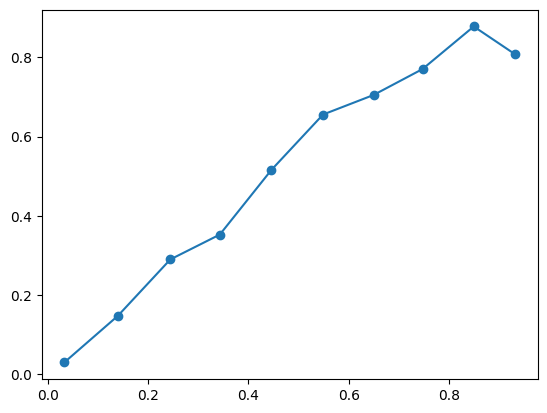

In [15]:
# import calibration curve
import matplotlib.pyplot as plt
from sklearn.calibration import calibration_curve           
                
from sklearn.calibration import calibration_curve
from matplotlib import pyplot

# fraction of positives, mean predicted value
probs = y_pred_proba
fraction_of_positives, mean_predicted_value = calibration_curve(y_test, probs, n_bins=10)
plt.plot(mean_predicted_value, fraction_of_positives, marker='o', label='XGBoost')

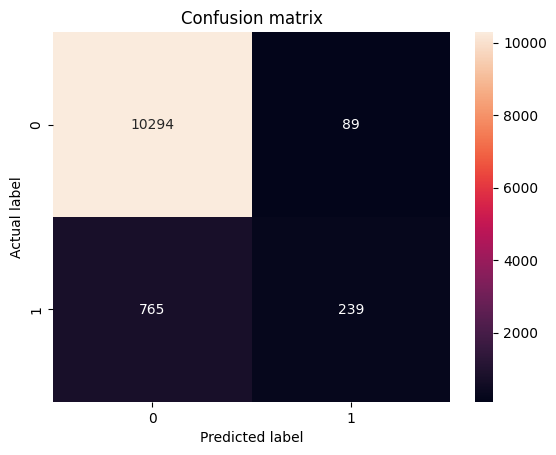

In [16]:
# show confusion matrix
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

cm = confusion_matrix(y_test, y_pred)
sns.heatmap(cm, annot=True, fmt='d')
plt.title('Confusion matrix')
plt.ylabel('Actual label')
plt.xlabel('Predicted label')
plt.show()


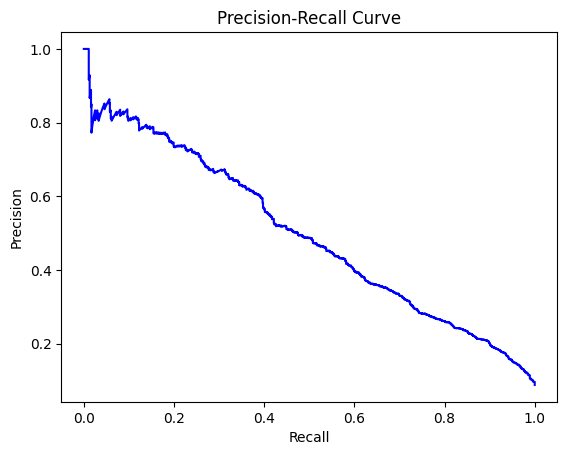

In [19]:
import matplotlib.pyplot as plt
from sklearn.metrics import precision_recall_curve

# assuming that you have already defined your model and made predictions
# on a test set and stored them in the variables y_true and y_pred

# calculate precision-recall curve
precision, recall, _ = precision_recall_curve(y_test, y_pred_proba)

# plot the curve
plt.plot(recall, precision, color='blue')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.show()

In [53]:
 #doing outliers 
 import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.metrics import auc
from sklearn.metrics import precision_recall_curve
from sklearn.model_selection import GridSearchCV
from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import HalvingGridSearchCV
#import log loss
from sklearn.metrics import log_loss


param_grid = {
    'learning_rate': [0.01, 0.1, 1],
    'max_depth': [3, 5, 7, 10],
    'n_estimators': [50, 100, 200],
    'subsample': [0.5, 0.7, 1],
    'colsample_bytree': [0.5, 0.7, 1],
    'reg_alpha': [ 0.1, 0.5],
    'reg_lambda': [0.1, 0.5]
}

xgb_model = xgb.XGBClassifier()

grid_search = HalvingGridSearchCV(estimator=xgb_model, param_grid=param_grid, cv=5, scoring='accuracy', n_jobs=-1, verbose = 10)
grid_search.fit(X_train, y_train)

#make predictions for test data
y_pred = grid_search.predict(X_test)
y_pred_proba = grid_search.predict_proba(X_test)[:,1]

n_iterations: 7
n_required_iterations: 7
n_possible_iterations: 7
min_resources_: 49
max_resources_: 36438
aggressive_elimination: False
factor: 3
----------
iter: 0
n_candidates: 1296
n_resources: 49
Fitting 5 folds for each of 1296 candidates, totalling 6480 fits
[CV 5/5; 1/1296] START colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1, subsample=0.5
[CV 1/5; 2/1296] START colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1, subsample=0.7
[CV 1/5; 1/1296] START colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1, subsample=0.5
[CV 3/5; 1/1296] START colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1, subsample=0.5
[CV 2/5; 2/1296] START colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1, subsample=0.7
[CV 2/5; 1/1296] START colsample_b

In [54]:
print(grid_search.best_params_)
xgb_model = xgb.XGBClassifier(**grid_search.best_params_)

log_loss = log_loss(y_test, y_pred_proba)
print("Log Loss: %.2f%%" % (log_loss * 100.0))

accuracy = accuracy_score(y_test, y_pred)
print("Accuracy: %.2f%%" % (accuracy * 100.0))

auc = roc_auc_score(y_test, y_pred_proba)
print("AUC: %.2f%%" % (auc * 100.0))

{'colsample_bytree': 0.7, 'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 200, 'reg_alpha': 0.1, 'reg_lambda': 0.5, 'subsample': 0.7}
Log Loss: 23.66%
Accuracy: 92.77%
AUC: 87.25%


In [85]:
# train test split
from sklearn.model_selection import train_test_split
import pandas as pd

X_train, X_test, y_train, y_test = train_test_split(X_transformed, df['hospital_death'], test_size=0.2, random_state=42)

In [65]:
# not doing outliers but doing everything including PCA
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.metrics import auc
from sklearn.metrics import precision_recall_curve
from sklearn.model_selection import GridSearchCV
from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import HalvingGridSearchCV
#import log loss
from sklearn.metrics import log_loss


param_grid = {
    'learning_rate': [0.01, 0.1, 1],
    'max_depth': [3, 5, 7, 10],
    'n_estimators': [50, 100, 200],
    'subsample': [0.5, 0.7, 1],
    'colsample_bytree': [0.5, 0.7, 1],
    'reg_alpha': [ 0.1, 0.5],
    'reg_lambda': [0.1, 0.5]
}

xgb_model = xgb.XGBClassifier()

grid_search = HalvingGridSearchCV(estimator=xgb_model, param_grid=param_grid, cv=5, scoring='accuracy', n_jobs=-1, verbose = 10)
grid_search.fit(X_train, y_train)

#make predictions for test data
y_pred = grid_search.predict(X_test)
y_pred_proba = grid_search.predict_proba(X_test)[:,1]

n_iterations: 7
n_required_iterations: 7
n_possible_iterations: 7
min_resources_: 49
max_resources_: 36438
aggressive_elimination: False
factor: 3
----------
iter: 0
n_candidates: 1296
n_resources: 49
Fitting 5 folds for each of 1296 candidates, totalling 6480 fits
[CV 4/5; 1/1296] START colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1, subsample=0.5[CV 1/5; 1/1296] START colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1, subsample=0.5

[CV 2/5; 2/1296] START colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1, subsample=0.7
[CV 3/5; 2/1296] START colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1, subsample=0.7
[CV 1/5; 2/1296] START colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1, subsample=0.7
[CV 3/5; 1/1296] START colsample_b

In [66]:
print(grid_search.best_params_)
xgb_model = xgb.XGBClassifier(**grid_search.best_params_)

log_loss = log_loss(y_test, y_pred_proba)
print("Log Loss: %.2f%%" % (log_loss * 100.0))

accuracy = accuracy_score(y_test, y_pred)
print("Accuracy: %.2f%%" % (accuracy * 100.0))

auc = roc_auc_score(y_test, y_pred_proba)
print("AUC: %.2f%%" % (auc * 100.0))

{'colsample_bytree': 0.7, 'learning_rate': 0.01, 'max_depth': 10, 'n_estimators': 50, 'reg_alpha': 0.1, 'reg_lambda': 0.1, 'subsample': 0.7}
Log Loss: 46.39%
Accuracy: 91.50%
AUC: 71.36%


In [86]:
# outliers and PCA being done
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.metrics import auc
from sklearn.metrics import precision_recall_curve
from sklearn.model_selection import GridSearchCV
from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import HalvingGridSearchCV
#import log loss
from sklearn.metrics import log_loss


param_grid = {
    'learning_rate': [0.01, 0.1, 1],
    'max_depth': [3, 5, 7, 10],
    'n_estimators': [50, 100, 200],
    'subsample': [0.5, 0.7, 1],
    'colsample_bytree': [0.5, 0.7, 1],
    'reg_alpha': [ 0.1, 0.5],
    'reg_lambda': [0.1, 0.5]
}

xgb_model = xgb.XGBClassifier()

grid_search = HalvingGridSearchCV(estimator=xgb_model, param_grid=param_grid, cv=5, scoring='accuracy', n_jobs=-1, verbose = 10)
grid_search.fit(X_train, y_train)

#make predictions for test data
y_pred = grid_search.predict(X_test)
y_pred_proba = grid_search.predict_proba(X_test)[:,1]

n_iterations: 7
n_required_iterations: 7
n_possible_iterations: 7
min_resources_: 22
max_resources_: 16457
aggressive_elimination: False
factor: 3
----------
iter: 0
n_candidates: 1296
n_resources: 22
Fitting 5 folds for each of 1296 candidates, totalling 6480 fits
[CV 4/5; 1/1296] START colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1, subsample=0.5[CV 3/5; 2/1296] START colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1, subsample=0.7

[CV 5/5; 1/1296] START colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1, subsample=0.5
[CV 2/5; 1/1296] START colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1, subsample=0.5
[CV 2/5; 2/1296] START colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1, subsample=0.7
[CV 1/5; 2/1296] START colsample_b

In [ ]:
print(grid_search.best_params_)
xgb_model = xgb.XGBClassifier(**grid_search.best_params_)

log_loss = log_loss(y_test, y_pred_proba)
print("Log Loss: %.2f%%" % (log_loss * 100.0))

accuracy = accuracy_score(y_test, y_pred)
print("Accuracy: %.2f%%" % (accuracy * 100.0))

auc = roc_auc_score(y_test, y_pred_proba)
print("AUC: %.2f%%" % (auc * 100.0))

In [ ]:
import shap

explainer = shap.Explainer(xgb_model)

sample_idx = 0
sample = X[sample_idx]
shap_values = explainer(sample)

# Visualize the SHAP values for the sample
shap.plots.waterfall(shap_values[sample_idx])